# ***Cassava Leaf Disease Detection 5- With InceptionResnetV5***

Importing required tools

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import tensorflow as tf
%matplotlib inline
%load_ext tensorboard
# To build CNN
from tensorflow.keras.layers import Dense, Flatten, Dropout
from keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard

from keras.applications import InceptionResNetV2
from keras import regularizers 
from keras import Model

In [ ]:
full_train = tf.data.experimental.load('/content/drive/MyDrive/cassava/full_data/train_full_data',
                                        element_spec=(tf.TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), tf.TensorSpec(shape=(None, 5), dtype=tf.float32, name=None)))
full_val = tf.data.experimental.load(path= '/content/drive/MyDrive/cassava/full_data/val_full_data',
                                      element_spec=(tf.TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), tf.TensorSpec(shape=(None, 5), dtype=tf.float32, name=None)))

In [ ]:
full_train.element_spec, full_val.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 5), dtype=tf.float32, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 5), dtype=tf.float32, name=None)))

### get disease names

In [ ]:
import json

with open("/content/drive/MyDrive/cassava/label_num_to_disease_map.json") as ds:
   disease_names = json.load(ds)

# We get dictionary from above lets convert into list
disease_names =[name for name in disease_names.values()]   
disease_names

['Cassava Bacterial Blight (CBB)',
 'Cassava Brown Streak Disease (CBSD)',
 'Cassava Green Mottle (CGM)',
 'Cassava Mosaic Disease (CMD)',
 'Healthy']

# Lets visualize images 

In [ ]:
# Create a function for viewing images in a data batch
def show_images(images,labels):
  """
  Displays images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(30):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(6, 6, i+1)
    # Display an image
    plt.imshow(images[i])
    # title label 
    plt.title(labels[i].argmax())
    # get rid of axis numbers
    plt.axis('off')

In [ ]:
train_images, train_labels = next(full_train.as_numpy_iterator())


### ***training images***

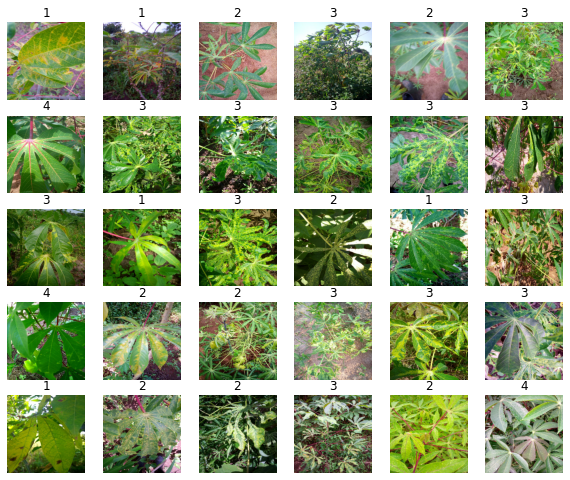

In [ ]:
show_images(train_images, train_labels)

### ***validation images with labels***

In [ ]:
val_images, val_labels = next(full_val.as_numpy_iterator())

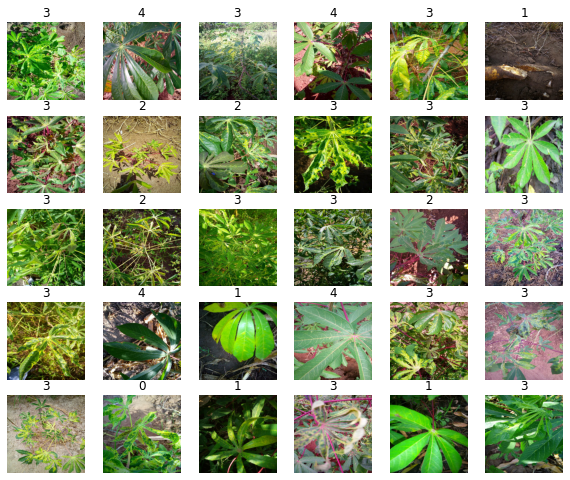

In [ ]:
show_images(val_images, val_labels)

# Lets train best inception resnet model on full data

In [ ]:
base_model = InceptionResNetV2(include_top=False, input_shape=(224,224,3))

In [ ]:
for i in range(400):
  base_model.layers[i].trainable=False

In [ ]:
for layer in base_model.layers:
  print(layer.trainable)

In [ ]:
# now build new FC layer,

top_model = base_model.output
top_model = tf.keras.layers.GlobalAveragePooling2D()(top_model)
# Flatten layer
top_model = Flatten()(top_model)
# Dense layers 
top_model = Dense(1024,activation='elu', kernel_regularizer=regularizers.L1L2(0.001,0.001))(top_model)
top_model = Dropout(0.5)(top_model)
top_model = Dense(1024,activation='elu', kernel_regularizer=regularizers.L1L2(0.001,0.001))(top_model)
top_model = Dropout(0.5)(top_model)
top_model = Dense(256,activation='elu', kernel_regularizer=regularizers.L1L2(0.001,0.001))(top_model)

# Output layer
top_model = Dense(5, activation='softmax')(top_model)

In [ ]:
inres_best = Model(inputs=base_model.input, outputs= top_model)
inres_best.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 111, 111, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 111, 111, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [ ]:
inres_best_callbacks = [ModelCheckpoint("/content/drive/MyDrive/cassava/calllbacks/checkpoints/inres_best"),
                          TensorBoard("/content/drive/MyDrive/cassava/calllbacks/Tensorboards/inres_best"),
                          EarlyStopping(patience=8, monitor='val_loss')]

In [ ]:
total_images = 21397
class_weight_0=(1./1087)*(total_images/2)
class_weight_1=(1./2189)*(total_images/2)
class_weight_2=(1./2386)*(total_images/2)
class_weight_3=(1./13158)*(total_images/2)
class_weight_4=(1./2577)*(total_images/2)

class_weights ={0: class_weight_0, 1: class_weight_1, 2: class_weight_2, 3: class_weight_3, 4: class_weight_4,}
class_weights

{0: 9.842226310947561,
 1: 4.887391502969392,
 2: 4.483864207879296,
 3: 0.813079495364037,
 4: 4.151532790065968}

In [ ]:
inres_best.compile(optimizer= 'adam', loss='categorical_crossentropy', metrics='accuracy')

In [ ]:
EPOCHS = 100  #@param {type:'slider', min:20, max:100, step:10}
EPOCHS


100

In [ ]:
inres_best_history = inres_best.fit(full_train,
                                              epochs=EPOCHS,
                                              validation_data=full_val,
                                              callbacks = inres_best_callbacks,
                                        class_weight=class_weights)

inres_best.save("/content/drive/MyDrive/cassava/Model/inres_best.h5")

Epoch 1/100
535/535 [==============================] - 338s 591ms/step - loss: 50.3606 - accuracy: 0.4113 - val_loss: 6.1427 - val_accuracy: 0.4023
INFO:tensorflow:Assets written to: /content/drive/MyDrive/cassava/calllbacks/checkpoints/inres_best/assets
Epoch 2/100
535/535 [==============================] - 318s 594ms/step - loss: 5.9807 - accuracy: 0.6604 - val_loss: 2.7296 - val_accuracy: 0.4815
INFO:tensorflow:Assets written to: /content/drive/MyDrive/cassava/calllbacks/checkpoints/inres_best/assets
Epoch 3/100
535/535 [==============================] - 320s 596ms/step - loss: 3.5070 - accuracy: 0.7052 - val_loss: 2.0998 - val_accuracy: 0.6558
INFO:tensorflow:Assets written to: /content/drive/MyDrive/cassava/calllbacks/checkpoints/inres_best/assets
Epoch 4/100
535/535 [==============================] - 319s 595ms/step - loss: 2.8938 - accuracy: 0.7542 - val_loss: 1.9990 - val_accuracy: 0.6089
INFO:tensorflow:Assets written to: /content/drive/MyDrive/cassava/calllbacks/checkpoints/i

In [ ]:
inres_best.evaluate(full_val)

134/134 [==============================] - 71s 530ms/step - loss: 1.8454 - accuracy: 0.7369


[1.845423698425293, 0.7369158864021301]

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/cassava/calllbacks/Tensorboards/inres_best

<IPython.core.display.Javascript object>

# Predictions

In [ ]:
model = tf.keras.models.load_model("/content/drive/MyDrive/cassava/Model/inres_best.h5")

In [ ]:
model.summary()

In [ ]:
predictions = model.predict(full_val)

In [ ]:
len(predictions)

4280

In [ ]:
def get_pred_label(pred_prob):
  '''
  getting name of disease from probabilities of prediction
  '''

  return disease_names[np.argmax(pred_prob)]

In [ ]:
get_pred_label(predictions[0])

'Cassava Mosaic Disease (CMD)'

In [ ]:
get_pred_label(predictions[500])

'Healthy'

In [ ]:
full_val

<_LoadDataset shapes: ((None, 224, 224, 3), (None, 5)), types: (tf.float32, tf.float32)>

#### Our data is in form of batch we have to unbatch it

In [ ]:
def unbatch_data(data):

  images = []
  labels = []

  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(disease_names[np.argmax(label)])
  return images, labels



In [ ]:
val_images, val_labels =  unbatch_data(full_val)

In [ ]:
def plot_predictions(images, labels, prediction_probabilities, n=1):

  image, true_label, pred_prob =  images[n], labels[n], prediction_probabilities[n]

  pred_label =  get_pred_label(pred_prob)
   
  plt.imshow(image)

  if pred_label == true_label:
    color='green'
  else:
    color = 'red'

  plt.title("{:.2f}% :{} {}".format((np.max(pred_prob))*100, 
                                                       pred_label, true_label),
                                                      color = color )
  plt.axis('off')

In [ ]:
for i in [7,5,49,16,3387,156,963,13,968,13,56,954,789,548,2989]:    
    n=i
    plot_predictions(images= val_images, labels=val_labels,prediction_probabilities=predictions, n=n)

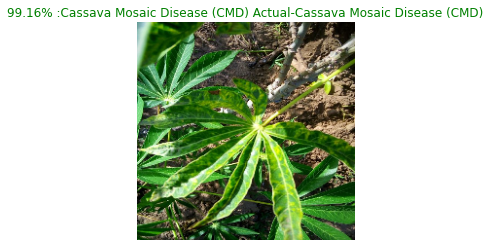

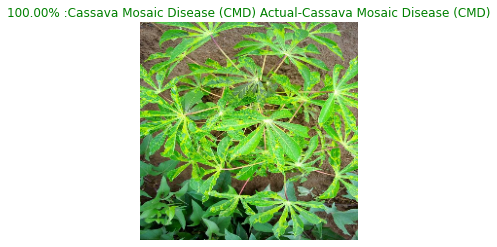

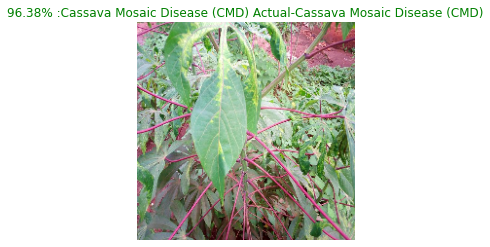

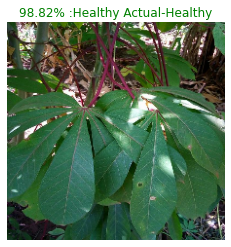

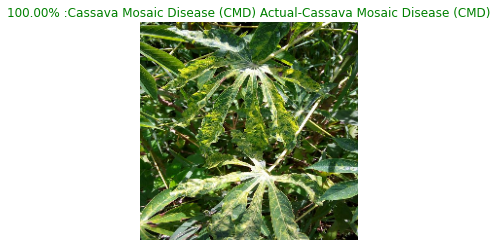

...

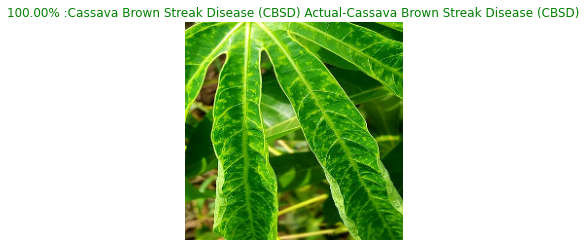

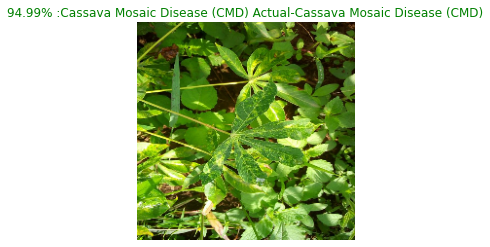

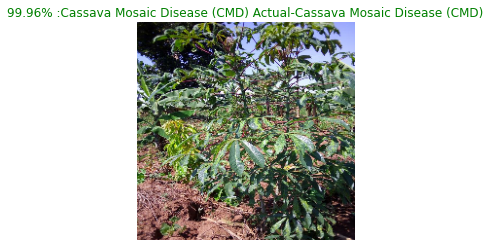

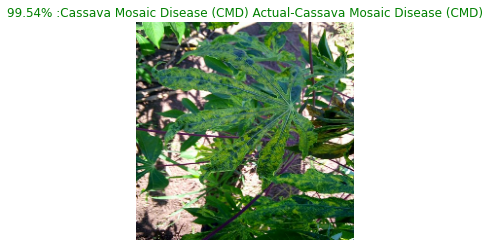

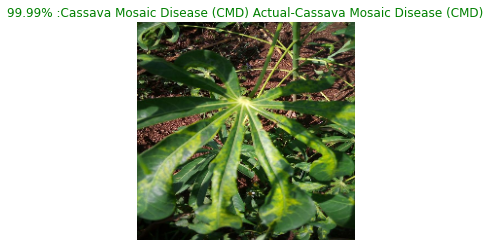

In [ ]:
for i in [7,5,49,16,3387,156,963,13,968,13,56,954,789,548,2989]:        
    plot_predictions(prediction_probabilities=predictions,
              labels=val_labels,
              images=val_images,
              n=i)
    plt.show()

In [ ]:
for i in [7,5,49,16,3387,156,963,13,968,13,56,954,789,548,2989]:    
  print(val_labels[i])

Cassava Green Mottle (CGM)
Cassava Brown Streak Disease (CBSD)
Cassava Mosaic Disease (CMD)
Cassava Green Mottle (CGM)
Cassava Mosaic Disease (CMD)
Cassava Mosaic Disease (CMD)
Cassava Mosaic Disease (CMD)
Cassava Green Mottle (CGM)
Cassava Mosaic Disease (CMD)
Cassava Green Mottle (CGM)
Cassava Mosaic Disease (CMD)
Cassava Mosaic Disease (CMD)
Healthy
Cassava Bacterial Blight (CBB)
Cassava Mosaic Disease (CMD)
